# Image Translation using a Pix2Pix GAN.
---

### What is a Gan?

Generative Adversarial Networks (GANs) are a deep-learning architecture for generative modeling. Introduced in 2014 by Ian Goodfellow and his team, this approach to create new data conditional on existing data has broad applications in data augmentation, generation and image-translation.

The GAN architecture consists of 2 major components: 
Generator:  trained to modify the input data to synthesize fake data.
Discriminator: The Discriminator is trained to determine whether the data is fake or whether it belongs to the original dataset.

The network is called adversarial since it involves the 2 major components seemingly working against each other. The generator tries to fool the discriminator by passing off synthesized data as real while the discriminator's job is to better identify a fake image from real.

The GAN network continues to generate more realistic data until the discriminator cannot distinguish between fake from real.

### Pix2Pix

The Pix2Pix framework was introduced by Philip Isola in their 2017 paper "Image-to-Image Translation with Conditional Adversarial Networks." 
  - Image to image translation involves transforming the image from one domain to another, for instance colorizing black & white photographs, transforming sketches to photographs, generating synthetic MRIs from X-rays. 
  -  Pix2Pix is a general technique, the same model and loss function ca nbe used for multiple image-to-image translation tasks. For instance, a model trained 
  - Pix2Pix GAN is a type of conditional GAN where the generated images are conditional on the source image.

### The Generator Model 

  - Based on the U-NET architecture. Each UNET block consists of an encoder, a bottlenecklayer and a decoder. Where the image is downsampled using the encoder, passed to a bottleneck layer and again upsampled to yield he image using a decoder. The encoder and decoder layers with the same number of filters are connected through skip connections to circumvent the bottleneck layer. 

### The PatchGAN Discriminator Model

  - The discriminator model takes in the input image and a pair of real/fake images to yield a prediction of      whether the image is real or generated by the generator (fake).
  - The PatchGAN is a Convolutional Neural Network and in the paper classifies $70 X 70$ patches of a $256 X 256$ image.
  - The discriminator of receptive field $70 X 70$ is moved across the image with a stride of $2 X 2$ yielding a single scaler after averaging the values.


### Composite Loss Function

### Dataset

In [17]:

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import os
from pathlib import Path
import pickle
from tensorflow.keras.layers import Input, Conv2D, LeakyReLU, Dropout, Concatenate, Conv2DTranspose, BatchNormalization, Activation
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.initializers import RandomNormal

from tensorflow.keras.utils import plot_model

In [18]:
data_path=r'D:/IDE/Virtual_Environments/tf/maps'
train_path = data_path + '/train/'
val_path = data_path + '/val/'

train_split_map = data_path + '/train_split_map/'
train_split_satellite = data_path + '/train_split_satellite/'
val_split_satellite = data_path + '/val_split_satellite/'
val_split_map = data_path + '/val_split_map/'
generated_images_dir = data_path + '/generated_images_dir/'
models_direc = data_path + '/models_direc/'

In [3]:
def separate_images(dataset_path):
    """
    Separates composite dataset images into satellite and map images.
    
    Args:
        train_path (str): Path to the directory containing composite images.
        
    Returns:
        tuple: Two numpy arrays containing satellite and map images.
    """
    source_satellite = []
    target_map = []
    
    for img in os.listdir(dataset_path):
        composite_image = tf.keras.utils.load_img(os.path.join(dataset_path, img))  # Load image
        composite_image = tf.keras.utils.img_to_array(composite_image)  # Convert to array
        #composite_image = tf.image.convert_image_dtype(composite_image, dtype=tf.float32)
        
        # width of image 1200 pixels
        satellite_image = composite_image[:, :600, :]  # Satellite image is on the left
        map_image = composite_image[:, 600:, :]  # Map image is on the right
        
        # Resize images to 256x256
        satellite_image = tf.image.resize(satellite_image, (256, 256))
        map_image = tf.image.resize(map_image, (256, 256))
        
        source_satellite.append(satellite_image)
        target_map.append(map_image)
    
    return np.array(source_satellite), np.array(target_map)

In [4]:
# 70 X 70 patchgan discriminator model
def build_discriminator(input_shape=(256, 256, 3)):
    """
    Builds a PatchGAN discriminator model.
    
    Args:
        input_shape (tuple): Shape of the input images.
        
    Returns:
        keras.Model: The 70 X 70 PatchGAN discriminator model.
    """
    #inputs = Input(shape=input_shape)
    weights_gaussian = tf.random_normal_initializer(mean=0.0, stddev=0.02)
    inp = Input(shape=input_shape, name='input_satellite_image')
    tar = Input(shape=input_shape, name='target_map_image')
    
    merged_input= Concatenate()([inp, tar])  # Concatenate satellite and map images
    
    # Layer 1
    x = Conv2D(64, kernel_size=4, strides=2, padding='same', kernel_initializer=weights_gaussian)(merged_input)
    x = LeakyReLU(alpha=0.2)(x)
    
    # Layer 2
    x = Conv2D(128, kernel_size=4, strides=2, padding='same',kernel_initializer=weights_gaussian)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    
    # Layer 3
    x = Conv2D(256, kernel_size=4, strides=2, padding='same', kernel_initializer=weights_gaussian)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    
    # Layer 4 
    x = Conv2D(512, kernel_size=4, strides=2, padding='same', kernel_initializer=weights_gaussian)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (second-last layer)
    x = Conv2D(512, kernel_size=4, padding='same', kernel_initializer=weights_gaussian)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    
    # Output layer
    last_layer = Conv2D(1, kernel_size=4, padding='same', kernel_initializer=weights_gaussian, activation='sigmoid')(x)
    
    model = Model(inputs=[inp,tar], outputs=last_layer, name='discriminator')
    
    # Compile the model
    model.compile(optimizer=Adam(2e-4, beta_1=0.5), loss='binary_crossentropy',loss_weights=[0.5])
    
    return model


### U-NET Generator Model

  - The Encoder block contains Convolution-Batchnorm-LeakyRelu.
  - The Decoder block contains Convolution-Batchnorm-DropOut-Relu.
  - filter size 4X4, stride of 2.

In [5]:
def enc_block(inp_layers, number_of_filters, apply_batchnorm=True):
    """
    Creates an encoder block for the UNET architecture.
    
    Args:
        inp_layers (keras.layers.Layer): Input layer for the block.
        number_of_filters (int): Number of filters for the convolutional layer.
        apply_batchnorm (bool): Whether to apply batch normalization.
        
    Returns:
        keras.layers.Layer: Encoder block model.
    """
    weights_gaussian = tf.keras.initializers.RandomNormal(mean=0.0,stddev=0.02)
    # downsampling layer
    x = Conv2D(number_of_filters, kernel_size=4, strides=2, padding='same', kernel_initializer=weights_gaussian)(inp_layers)
    if apply_batchnorm:
        x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    return x

In [6]:
# Decoder block
def dec_block(inp_layers,skip_connection, number_of_filters, apply_dropout=True):
    """
    Creates a decoder block for the UNET architecture.
    
    Args:
        inp_layers (keras.layers.Layer): Input layer for the block.
        number_of_filters (int): Number of filters for the convolutional layer.
        skip_connection (keras.layers.Layer): Skip connection from the encoder block.
        apply_dropout (bool): Whether to apply dropout in the block.
        
    Returns:
        keras.layers.Layer: Decoder block model.
    """
    weights_gaussian = tf.keras.initializers.RandomNormal(stddev=0.02)
    # upsampling layer
    x = Conv2DTranspose(number_of_filters, kernel_size=4, strides=2, padding='same', kernel_initializer=weights_gaussian)(inp_layers)
    x = BatchNormalization()(x, training=True)  # Use training=True for batch normalization
    # apply dropout if specified
    if apply_dropout:
        x = Dropout(0.5)(x, training=True)  # Use training=True for dropout
    # Concatenate the upsampled layer with the skip connection
    x = Concatenate()([x, skip_connection])
    x = Activation('relu')(x)    
    return x

In [7]:
# Generator model
def build_generator(input_shape=(256, 256, 3)):
    """
    Builds a U-Net generator model.
    
    Args:
        input_shape (tuple): Shape of the input images.
        
    Returns:
        keras.Model: The generator model.
    """
    input_image = Input(shape=input_shape)
    weights_gaussian = tf.keras.initializers.RandomNormal(mean=0.0,stddev=0.02)
    # Encoder
    e1 = enc_block(input_image, 64, apply_batchnorm=False)  # No batch norm on first layer
    e2 = enc_block(e1, 128)
    e3 = enc_block(e2, 256)
    e4 = enc_block(e3, 512)
    e5 = enc_block(e4, 512)
    e6 = enc_block(e5, 512)
    e7 = enc_block(e6, 512)
    #e8 = enc_block(e7, 512)
    # Bottleneck, no batchnorma and relu 
    #b = enc_block(e7, 512)
    bottleneck = Conv2D(512, kernel_size=4, strides=2, padding='same', kernel_initializer=weights_gaussian)(e7)
    bottleneck= Activation('relu')(bottleneck)
    
    # Decoder
    
    d1 = dec_block(bottleneck,  e7, 512)
    d2 = dec_block(d1, e6, 512)
    d3 = dec_block(d2, e5, 512)
    d4 = dec_block(d3, e4, 512,apply_dropout=False)
    d5 = dec_block(d4, e3, 256,apply_dropout=False)
    d6 = dec_block(d5, e2, 128,apply_dropout=False)
    d7 = dec_block(d6, e1, 64,apply_dropout=False)
    
    
    # Output layer
    outputs = Conv2DTranspose(3, kernel_size=4, strides=2, padding='same', activation='tanh')(d7)
    
    model = Model(inputs=input_image, outputs=outputs, name='generator')
    
    return model

In [8]:
def combined_model(generator, discriminator, image_shape):
    """
    Creates a combined model for training the generator.
    
    Args:
        generator (keras.Model): The generator model.
        discriminator (keras.Model): The discriminator model.
        image_shape (tuple): Shape of the input images.
        
    Returns:
        keras.Model: The combined model.
    """
    input_image = Input(shape=image_shape, name='input_satellite_image')   # (256, 256, 3)
    generated_map = generator(input_image)
    
    # Freeze the discriminator during generator training
    for layer in discriminator.layers:
        if not isinstance(layer, layers.BatchNormalization):
            layer.trainable = False
    disc_output = discriminator([input_image, generated_map])
    
    # Create optimizers
    optimizer = Adam(2e-4, beta_1=0.5)
    
    composite_model = Model(inputs=input_image, outputs=[generated_map, disc_output], name='combined_model')
    composite_model.compile(optimizer=optimizer, 
                          loss=['mae', 'binary_crossentropy'], 
                          loss_weights=[100, 1]) # L1 loss weighted more than adversarial loss
    
    return composite_model

In [10]:
def generate_and_save_images(generator_model, satellite_images_val, map_images_val, output_dir='generated_images_dir'):
    """
    Generates and saves images using the generator_model model.
    
    Args:
        generator_model (keras.Model): The generator_model model.
        satellite_images_val (np.ndarray): Array of Validation satellite images.
        map_images_val (np.ndarray): Array of map images for testing.
        output_dir (str): Directory to save the generated images.
    """
    
    num_samples= 3
    idx= np.random.choice(len(satellite_images_val), num_samples, replace=False)
    sample_sat_val = satellite_images_val[idx]
    sample_target_val = map_images_val[idx]
    sample_generated_map = generator_model.predict(satellite_images_val)
    
    # scale pixels from [-1,1] to [0,1]
    sample_sat_val = (sample_sat_val + 1) / 2.0 
    sample_target_val = (sample_target_val + 1) / 2.0
    sample_generated_map = (sample_generated_map + 1) / 2.0
    
    title = ['Input Image', 'Ground Truth', 'Predicted Map']
    plt.figure(figsize=(10, num_samples * 3))
    for i in range(num_samples):
        # Display the input satellite image
        plt.subplot(num_samples, 3, i * 3 + 1)
        display_image = sample_sat_val[i]
        plt.imshow(display_image)
        plt.title(title[0])
        plt.axis('off')
        
        # Display the ground truth map
        plt.subplot(num_samples, 3, i * 3 + 2)
        display_image = sample_target_val[i]
        plt.imshow(display_image)
        plt.title(title[1])
        plt.axis('off')
        
        # Display the generated map
        plt.subplot(num_samples, 3, i * 3 + 3)
        display_image = sample_generated_map[i]
        plt.imshow(display_image)
        plt.title(title[2])
        plt.axis('off')
    plt.tight_layout()
    plt.show()
    plt.savefig(os.path.join(output_dir, 'generated_image.png'))
    plt.close()

In [12]:
# Training loop for Pix2Pix GAN
def train_on_batch(generator_model, discriminator_model, gan_model,source_satellite, source_maps,source_satellite_test, source_maps_test,):
    """
    Trains the Pix2Pix GAN on a single batch of data.
    
    Args:
        generator_model (keras.Model): The generator_model model.
        discriminator_model (keras.Model): The discriminator_model model.
        source_satellite (np.ndarray): Array of satellite training images.
        source_maps (np.ndarray): Array of map training images.
        source_satellite_test (np.ndarray): Array of test satellite images.
        source_maps_test (np.ndarray): Array of test map images.
        
    Returns:
        tuple: Losses for the generator_model and discriminator_model.
    """

    epochs = 10
    batch_size = 1
    lambda_weight = 100

    for epoch in range(epochs):
        print(f"Epoch {epoch+1}/{epochs}")
        num_batches = len(source_satellite) // batch_size
        for batch in range(num_batches):
            # select a random batch of images
            idx = np.random.randint(0, len(source_satellite), batch_size)
            real_satellite = source_satellite[idx]
            real_maps = source_maps[idx]
            
            # compute discriminator_model loss
            disc_real_loss = discriminator_model.train_on_batch([real_satellite, real_maps], tf.ones((batch_size, 16, 16, 1)))
            fake_maps = generator_model.predict(real_satellite)
            disc_fake_loss = discriminator_model.train_on_batch([real_satellite, fake_maps], tf.zeros((batch_size, 16, 16, 1)))
            
            # compute generator_model loss
            gener_loss,_ , _ = gan_model.train_on_batch(real_satellite, [fake_maps, tf.ones((batch_size, 16, 16, 1))])
            
            # summarize performance
            if (batch + 1) % 500 == 0:
                generate_and_save_images(generator_model, source_satellite_test, source_maps_test, output_dir= generated_images_dir)
            print(f"Batch {batch+1}/{num_batches}, D Real_Loss: {disc_real_loss:.4f}, D Fake_Loss: {disc_fake_loss:.4f} , G total_Loss: {gener_loss:.4f}")
            # Save the generator model when epochs are multiples of 5 and batch is a multiple of 500
            if (epoch + 1) % 5 == 0 and (batch + 1) % 500 == 0:
                generator_model.save(os.path.join(models_direc, f'generator_model_epoch{epoch}_batch{batch}.keras'))
                
            
    #Print("Training complete.")        
            
        

In [11]:
def load_data(train_satellite, train_map, test_satellite, test_map):
    """
    Loads the training and validation data for the Pix2Pix GAN.
    
    Returns:
        tuple: Arrays of source satellite images, source maps, source satellite test images, and source maps test images.
    """
    # Load the data from the specified paths
    
    
    import pickle
    with open(os.path.join(train_split_satellite, 'train_satellite_images.pkl'), 'rb') as f:
        train_sat_split = pickle.load(f)
        source_satellite = train_sat_split
    # source_satellite = np.load(os.path.join(train_path, 'source_satellite.npy'))
    with open(os.path.join(train_split_map, 'map_images_train.pkl'), 'rb') as f:
        train_map_split = pickle.load(f)
        source_maps = train_map_split

    # source_maps = np.load(os.path.join(train_path, 'source_maps.npy'))
    with open(os.path.join(val_split_satellite, 'satellite_images_val.pkl'), 'rb') as f:
        satellite_images_val = pickle.load(f)
        source_satellite_test = satellite_images_val

    # source_satellite_test = np.load(os.path.join(test_path, 'source_satellite_test.npy'))

    with open(os.path.join(val_split_map, 'map_images_val.pkl'), 'rb') as f:
        map_images_val = pickle.load(f)
        source_maps_test = map_images_val
        
    # print shapes
    # print("Source Satellite Shape:", source_satellite.shape)
    # print("Source Maps Shape:", source_maps.shape)
    # print("Source Satellite Test Shape:", source_satellite_test.shape)
    # print("Source Maps Test Shape:", source_maps_test.shape)
    img_shape = source_satellite.shape[1:]  # Get the shape of the images
    
    # scale from [0,255] to [-1,1]
    source_satellite = (source_satellite / 127.5) - 1.0
    source_maps = (source_maps / 127.5) - 1.0
    source_satellite_test = (source_satellite_test / 127.5) - 1.0
    source_maps_test = (source_maps_test / 127.5) - 1.0
    # print("Source Satellite Shape:", source_satellite.shape)
    # print("Source Maps Shape:", source_maps.shape)
    # print("Source Satellite Test Shape:", source_satellite_test.shape)
    # print("Source Maps Test Shape:", source_maps_test.shape)
    
    
    return source_satellite, source_maps, source_satellite_test, source_maps_test, img_shape


In [12]:
# Load data
sat_train,train_map,val_sat,val_map ,input_shape= load_data(train_split_satellite, train_split_map, val_split_satellite, val_split_map)

In [13]:
# Build and compile models
generator_model = build_generator()
discriminator_model = build_discriminator()
gan_model = combined_model(generator_model, discriminator_model, input_shape)

d:\IDE\Virtual_Environments\tf\tensor_keras\Lib\site-packages\keras\src\layers\activations\leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


In [14]:
# plot model
discriminator_model.summary()
generator_model.summary()
# plot_model(generator_model, to_file=os.path.join(check_path, 'generator_model.png'), show_shapes=True, show_layer_names=True)
# plot_model(gan_model, to_file=os.path.join(check_path, 'gan_model.png'), show_shapes=True, show_layer_names=True)
# plot_model(discriminator_model, to_file=os.path.join(check_path, 'discriminator_model.png'), show_shapes=True, show_layer_names=True)

Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_satellite_im… │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ target_map_image    │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_7       │ (None, 256, 256,  │          0 │ input_satellite_… │
│ (Concatenate)       │ 6)                │            │ target_map_image… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_8 (Conv2D)   │ (None, 128, 128,  │      6,208 │ concatenate_7[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_7       │ (None, 128, 128,  │          0 │ conv2d_8[0][0]    │
│ (LeakyReLU)         │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_9 (Conv2D)   │ (None, 64, 64,    │    131,200 │ leaky_re_lu_7[0]… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │        512 │ conv2d_9[0][0]    │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_8       │ (None, 64, 64,    │          0 │ batch_normalizat… │
│ (LeakyReLU)         │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_10 (Conv2D)  │ (None, 32, 32,    │    524,544 │ leaky_re_lu_8[0]… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │      1,024 │ conv2d_10[0][0]   │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_9       │ (None, 32, 32,    │          0 │ batch_normalizat… │
│ (LeakyReLU)         │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_11 (Conv2D)  │ (None, 16, 16,    │  2,097,664 │ leaky_re_lu_9[0]… │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 16, 16,    │      2,048 │ conv2d_11[0][0]   │
│ (BatchNormalizatio… │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_10      │ (None, 16, 16,    │          0 │ batch_normalizat… │
│ (LeakyReLU)         │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_12 (Conv2D)  │ (None, 16, 16,    │  4,194,816 │ leaky_re_lu_10[0… │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 16, 16,    │      2,048 │ conv2d_12[0][0]   │
│ (BatchNormalizatio… │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_11      │ (None, 16, 16,    │          0 │ batch_normalizat

 Total params: 6,968,257 (26.58 MB)

 Trainable params: 2,816 (11.00 KB)

 Non-trainable params: 6,965,441 (26.57 MB)

Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 128, 128,  │      3,136 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu         │ (None, 128, 128,  │          0 │ conv2d[0][0]      │
│ (LeakyReLU)         │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 64, 64,    │    131,200 │ leaky_re_lu[0][0] │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 64, 64,    │        512 │ conv2d_1[0][0]    │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_1       │ (None, 64, 64,    │          0 │ batch_normalizat… │
│ (LeakyReLU)         │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 32, 32,    │    524,544 │ leaky_re_lu_1[0]… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │      1,024 │ conv2d_2[0][0]    │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_2       │ (None, 32, 32,    │          0 │ batch_normalizat… │
│ (LeakyReLU)         │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 16, 16,    │  2,097,664 │ leaky_re_lu_2[0]… │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 16, 16,    │      2,048 │ conv2d_3[0][0]    │
│ (BatchNormalizatio… │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_3       │ (None, 16, 16,    │          0 │ batch_normalizat… │
│ (LeakyReLU)         │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 8, 8, 512) │  4,194,816 │ leaky_re_lu_3[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 8, 8, 512) │      2,048 │ conv2d_4[0][0]    │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_4       │ (None, 8, 8, 512) │          0 │ batch_normalizat… │
│ (LeakyReLU)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_5 (Conv2D)   │ (None, 4, 4, 512) │  4,194,816 │ leaky_re_lu_4[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 4, 4, 512) │      2,048 │ conv2d_5[0][0]    │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼─────────────────

 Total params: 54,429,315 (207.63 MB)

 Trainable params: 54,419,459 (207.59 MB)

 Non-trainable params: 9,856 (38.50 KB)

Epoch 1/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
Batch 1/1096, D Real_Loss: 0.5143, D Fake_Loss: 0.4201 , G total_Loss: 25.3070
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
Batch 2/1096, D Real_Loss: 0.4677, D Fake_Loss: 0.4274 , G total_Loss: 25.0072
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 518ms/step
Batch 3/1096, D Real_Loss: 0.4558, D Fake_Loss: 0.4273 , G total_Loss: 24.1093
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step
Batch 4/1096, D Real_Loss: 0.4477, D Fake_Loss: 0.4286 , G total_Loss: 22.8910
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step
Batch 5/1096, D Real_Loss: 0.4434, D Fake_Loss: 0.4293 , G total_Loss: 21.4903
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 732ms/step
Batch 6/1096, D Real_Loss: 0.4391, D Fake_Loss: 0.4289 , G total_Loss: 19.8943
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step   
Batch 7/1096, D Real_Loss: 0.4396, D Fake_Loss: 0.4303 , G total_Loss: 18.9450
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 716ms/step
Batch 8/1096, D Real_Loss: 0.4386, D Fake_Loss: 0.4308 , G total_Loss: 17.5998
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 793ms/step
Batch 9/1

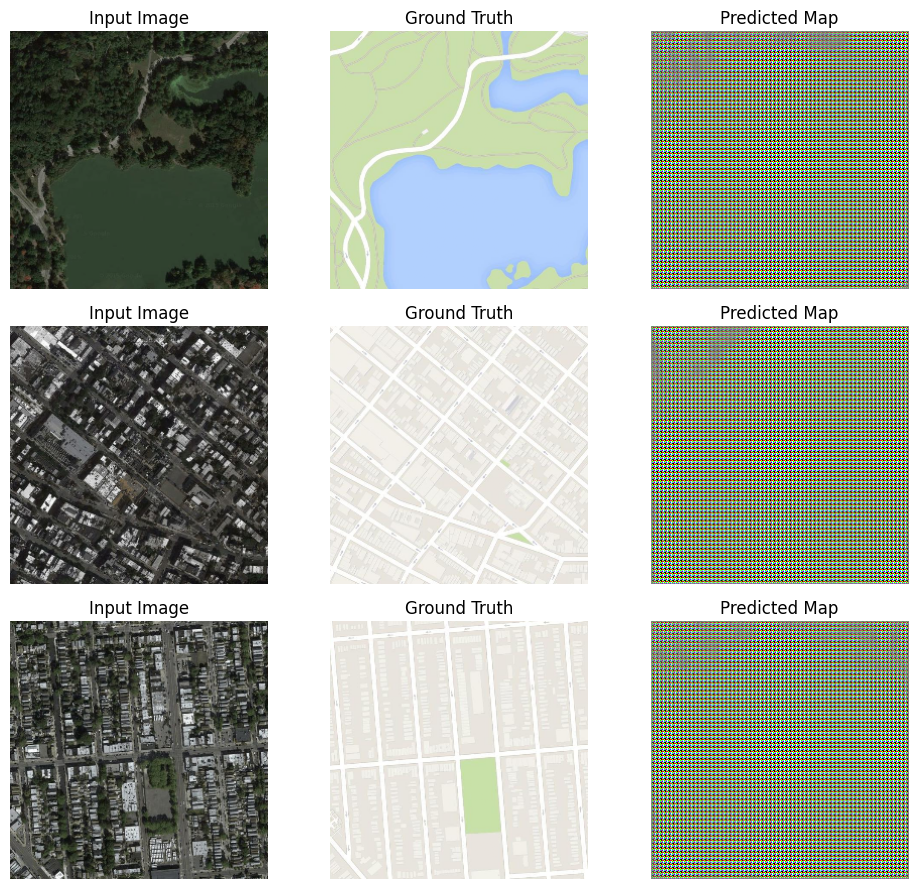

Batch 500/1096, D Real_Loss: 0.4241, D Fake_Loss: 0.4243 , G total_Loss: 3.6468
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step
Batch 501/1096, D Real_Loss: 0.4241, D Fake_Loss: 0.4243 , G total_Loss: 3.6460
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 586ms/step
Batch 502/1096, D Real_Loss: 0.4241, D Fake_Loss: 0.4243 , G total_Loss: 3.6450
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 624ms/step
Batch 503/1096, D Real_Loss: 0.4241, D Fake_Loss: 0.4244 , G total_Loss: 3.6446
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 634ms/step
Batch 504/1096, D Real_Loss: 0.4242, D Fake_Loss: 0.4244 , G total_Loss: 3.6446
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 902ms/step
Batch 505/1096, D Real_Loss: 0.4242, D Fake_Loss: 0.4244 , G total_Loss: 3.6436
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 749ms/step
Batch 506/1096, D Real_Loss: 0.4242, D Fake_Loss: 0.4245 , G total_Loss: 3.6425
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 732ms/step
Batch 507/1096, D Real_Loss: 0.4243, D Fake_Loss: 0.4245 , G total_Loss: 3.6414
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 602ms/step
Batch 508/1096, D Real_Loss: 0.4243, D Fake_Loss

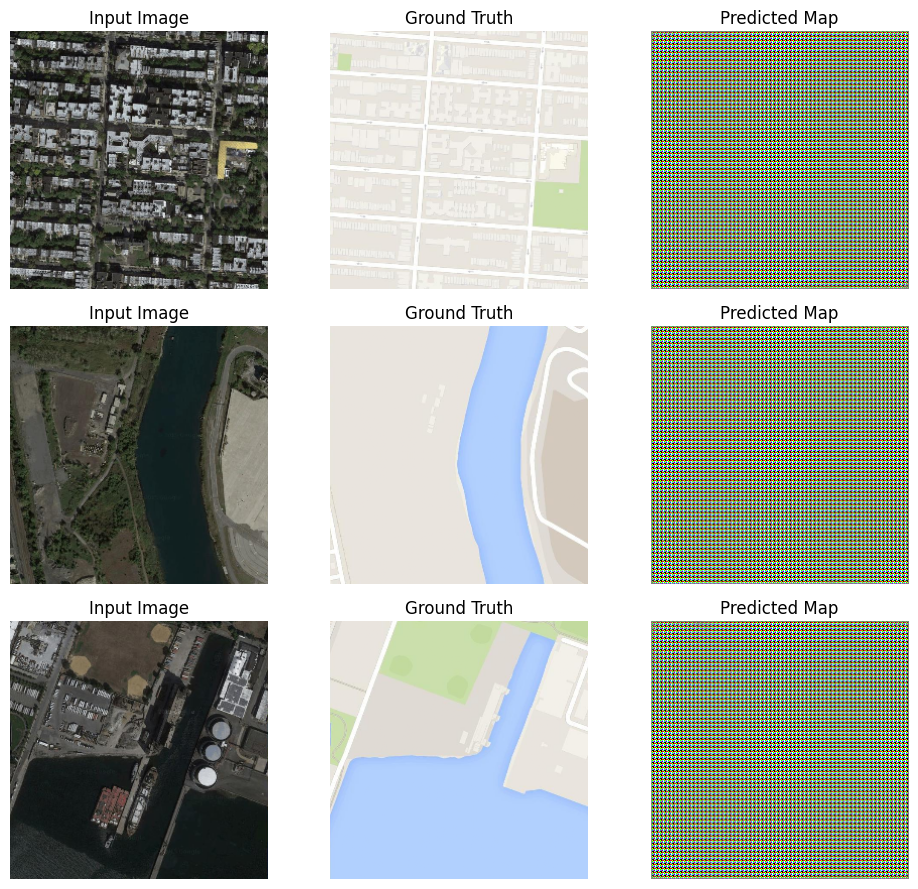

Batch 1000/1096, D Real_Loss: 0.4333, D Fake_Loss: 0.4334 , G total_Loss: 2.4795
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step
Batch 1001/1096, D Real_Loss: 0.4333, D Fake_Loss: 0.4334 , G total_Loss: 2.4780
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
Batch 1002/1096, D Real_Loss: 0.4333, D Fake_Loss: 0.4334 , G total_Loss: 2.4761
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step
Batch 1003/1096, D Real_Loss: 0.4333, D Fake_Loss: 0.4335 , G total_Loss: 2.4745
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step
Batch 1004/1096, D Real_Loss: 0.4333, D Fake_Loss: 0.4335 , G total_Loss: 2.4734
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step
Batch 1005/1096, D Real_Loss: 0.4333, D Fake_Loss: 0.4335 , G total_Loss: 2.4724
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
Batch 1006/1096, D Real_Loss: 0.4334, D Fake_Loss: 0.4335 , G total_Loss: 2.4712
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step
Batch 1007/1096, D Real_Loss: 0.4334, D Fake_Loss: 0.4335 , G total_Loss: 2.4699
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step
Batch 1008/1096, D Real_Loss: 0.4334, D 

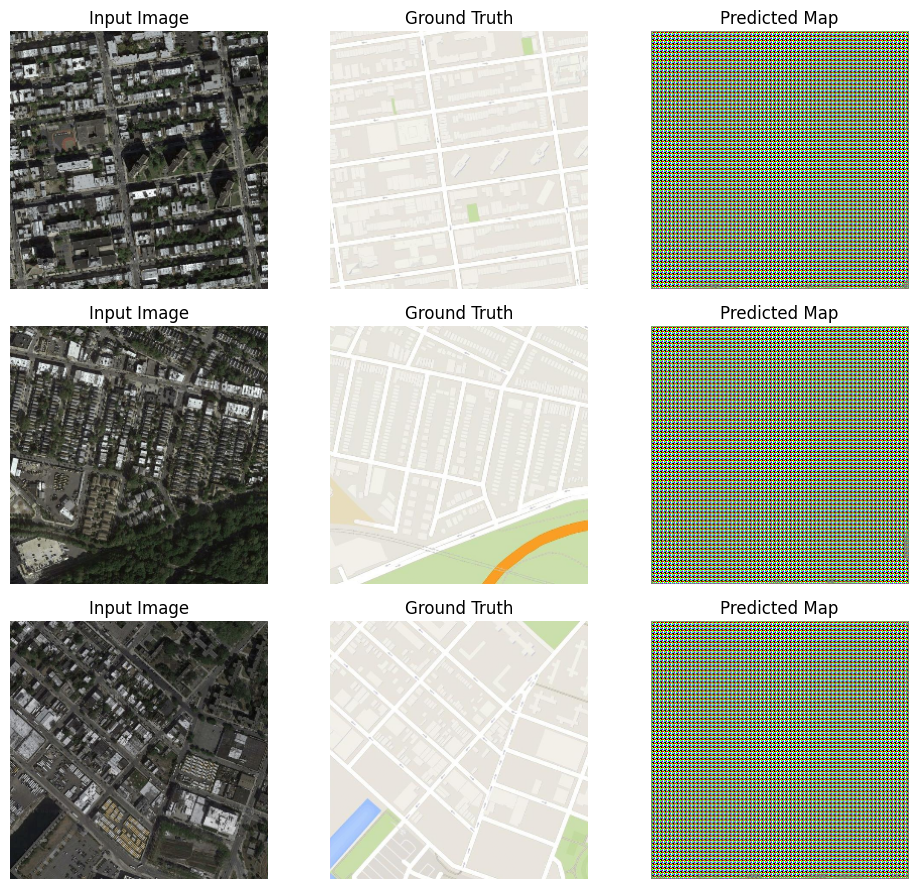

Batch 500/1096, D Real_Loss: 0.4382, D Fake_Loss: 0.4383 , G total_Loss: 2.0255
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 564ms/step
Batch 501/1096, D Real_Loss: 0.4382, D Fake_Loss: 0.4383 , G total_Loss: 2.0246
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 913ms/step
Batch 502/1096, D Real_Loss: 0.4382, D Fake_Loss: 0.4383 , G total_Loss: 2.0236
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 479ms/step
Batch 503/1096, D Real_Loss: 0.4382, D Fake_Loss: 0.4383 , G total_Loss: 2.0226
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step   
Batch 504/1096, D Real_Loss: 0.4382, D Fake_Loss: 0.4383 , G total_Loss: 2.0217
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 611ms/step
Batch 505/1096, D Real_Loss: 0.4382, D Fake_Loss: 0.4383 , G total_Loss: 2.0207
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 745ms/step
Batch 506/1096, D Real_Loss: 0.4383, D Fake_Loss: 0.4384 , G total_Loss: 2.0197
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step
Batch 507/1096, D Real_Loss: 0.4383, D Fake_Loss: 0.4384 , G total_Loss: 2.0188
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 636ms/step
Batch 508/1096, D Real_Loss: 0.4383, D Fake_Loss

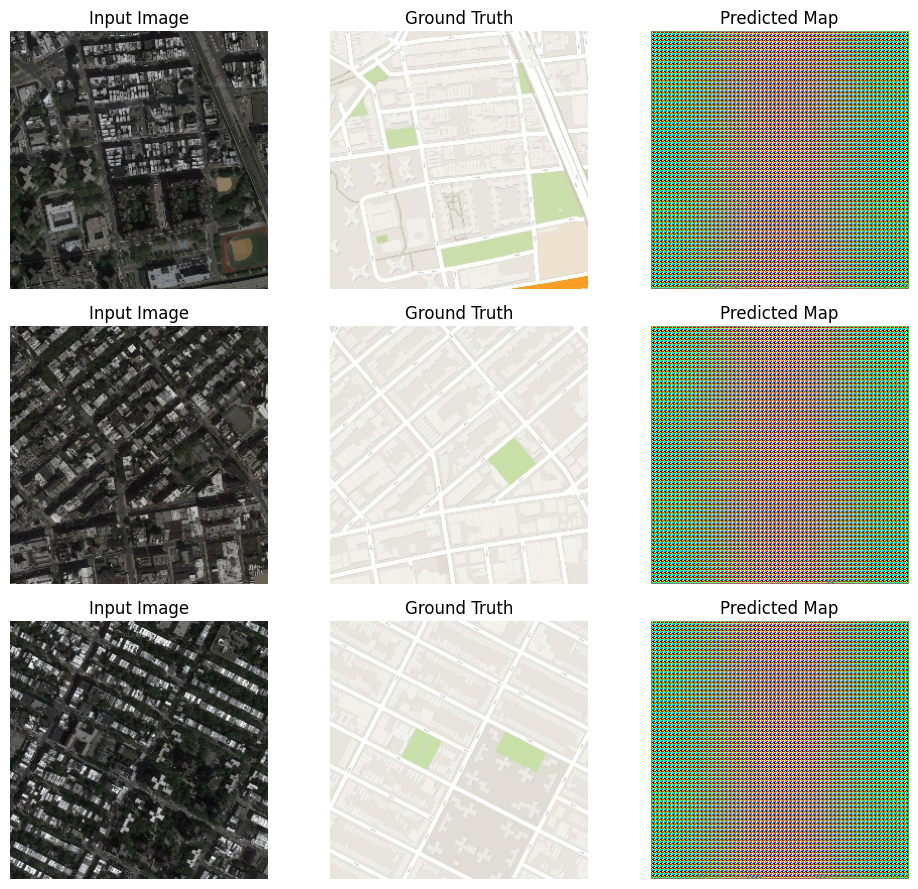

Batch 1000/1096, D Real_Loss: 0.4403, D Fake_Loss: 0.4403 , G total_Loss: 1.8106
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
Batch 1001/1096, D Real_Loss: 0.4403, D Fake_Loss: 0.4404 , G total_Loss: 1.8099
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 692ms/step
Batch 1002/1096, D Real_Loss: 0.4403, D Fake_Loss: 0.4404 , G total_Loss: 1.8093
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step
Batch 1003/1096, D Real_Loss: 0.4403, D Fake_Loss: 0.4404 , G total_Loss: 1.8087
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 565ms/step
Batch 1004/1096, D Real_Loss: 0.4403, D Fake_Loss: 0.4404 , G total_Loss: 1.8080
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step
Batch 1005/1096, D Real_Loss: 0.4403, D Fake_Loss: 0.4404 , G total_Loss: 1.8073
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
Batch 1006/1096, D Real_Loss: 0.4403, D Fake_Loss: 0.4404 , G total_Loss: 1.8067
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 569ms/step
Batch 1007/1096, D Real_Loss: 0.4403, D Fake_Loss: 0.4403 , G total_Loss: 1.8061
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
Batch 1008/1096, D Real_Loss: 0.4403, D 

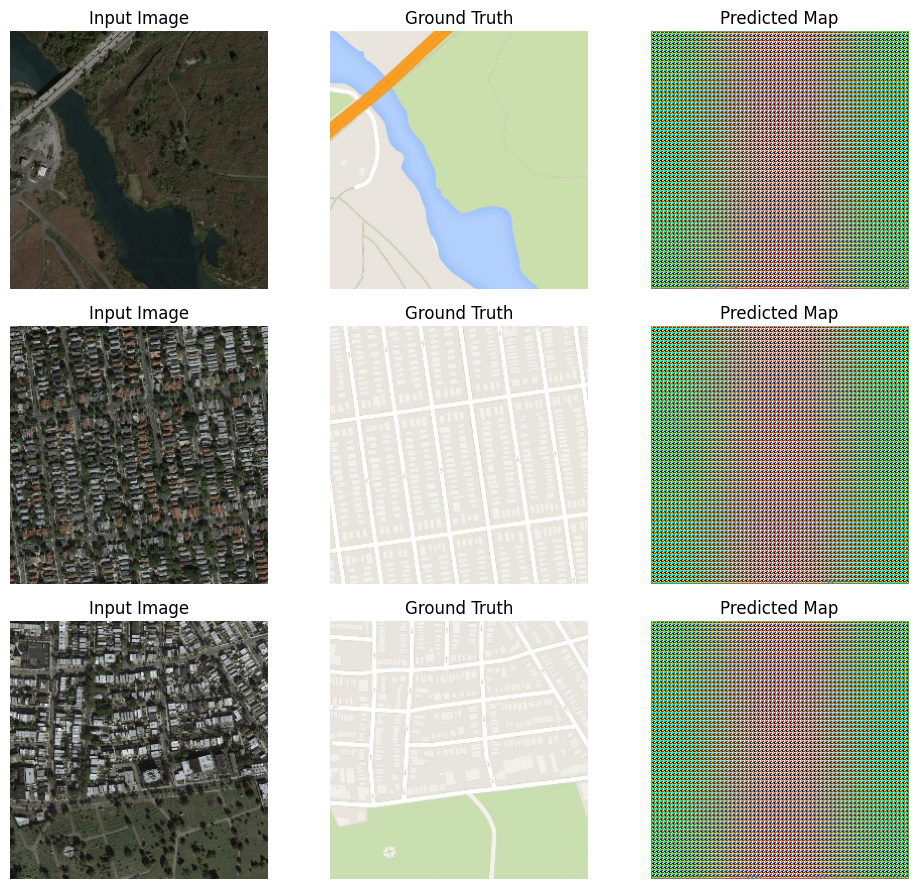

Batch 500/1096, D Real_Loss: 0.4410, D Fake_Loss: 0.4411 , G total_Loss: 1.5002
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
Batch 501/1096, D Real_Loss: 0.4410, D Fake_Loss: 0.4411 , G total_Loss: 1.4998
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 670ms/step
Batch 502/1096, D Real_Loss: 0.4410, D Fake_Loss: 0.4411 , G total_Loss: 1.4994
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
Batch 503/1096, D Real_Loss: 0.4410, D Fake_Loss: 0.4411 , G total_Loss: 1.4990
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 693ms/step
Batch 504/1096, D Real_Loss: 0.4410, D Fake_Loss: 0.4411 , G total_Loss: 1.4986
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
Batch 505/1096, D Real_Loss: 0.4410, D Fake_Loss: 0.4411 , G total_Loss: 1.4982
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 657ms/step
Batch 506/1096, D Real_Loss: 0.4410, D Fake_Loss: 0.4411 , G total_Loss: 1.4977
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 640ms/step
Batch 507/1096, D Real_Loss: 0.4410, D Fake_Loss: 0.4411 , G total_Loss: 1.4973
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step
Batch 508/1096, D Real_Loss: 0.4410, D Fake_Loss

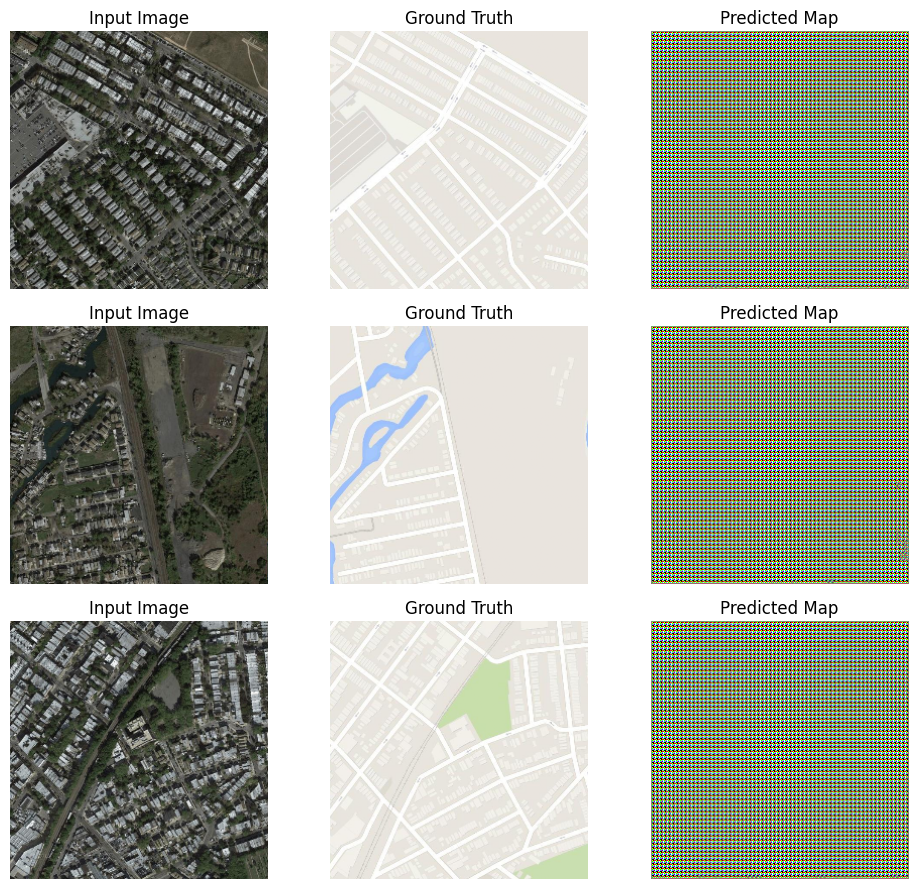

Batch 1000/1096, D Real_Loss: 0.4411, D Fake_Loss: 0.4412 , G total_Loss: 1.3316
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step
Batch 1001/1096, D Real_Loss: 0.4411, D Fake_Loss: 0.4412 , G total_Loss: 1.3313
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 579ms/step
Batch 1002/1096, D Real_Loss: 0.4411, D Fake_Loss: 0.4412 , G total_Loss: 1.3310
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 608ms/step
Batch 1003/1096, D Real_Loss: 0.4412, D Fake_Loss: 0.4412 , G total_Loss: 1.3307
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 689ms/step
Batch 1004/1096, D Real_Loss: 0.4412, D Fake_Loss: 0.4412 , G total_Loss: 1.3304
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 645ms/step
Batch 1005/1096, D Real_Loss: 0.4412, D Fake_Loss: 0.4412 , G total_Loss: 1.3301
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 607ms/step
Batch 1006/1096, D Real_Loss: 0.4412, D Fake_Loss: 0.4412 , G total_Loss: 1.3298
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 762ms/step
Batch 1007/1096, D Real_Loss: 0.4411, D Fake_Loss: 0.4412 , G total_Loss: 1.3295
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 647ms/step
Batch 1008/1096, D Real_Loss: 0.4411, D 

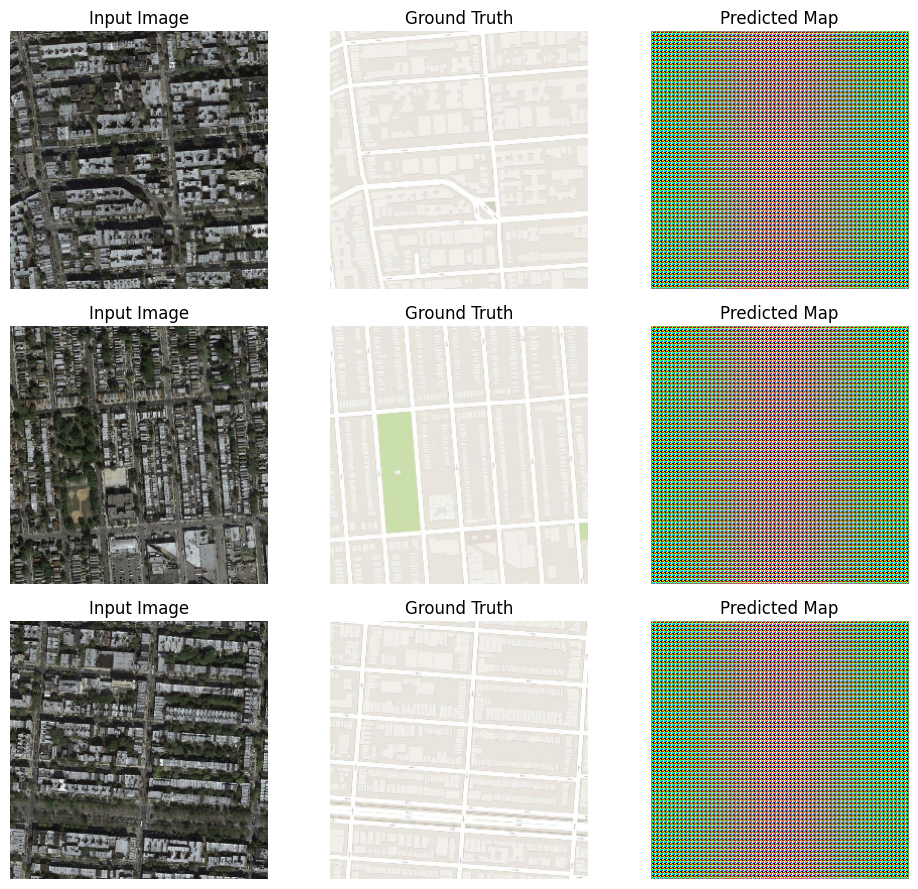

Batch 500/1096, D Real_Loss: 0.4411, D Fake_Loss: 0.4412 , G total_Loss: 1.4353
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 401ms/step
Batch 501/1096, D Real_Loss: 0.4411, D Fake_Loss: 0.4412 , G total_Loss: 1.4350
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
Batch 502/1096, D Real_Loss: 0.4411, D Fake_Loss: 0.4412 , G total_Loss: 1.4347
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step   
Batch 503/1096, D Real_Loss: 0.4411, D Fake_Loss: 0.4412 , G total_Loss: 1.4344
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 759ms/step
Batch 504/1096, D Real_Loss: 0.4411, D Fake_Loss: 0.4411 , G total_Loss: 1.4342
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
Batch 505/1096, D Real_Loss: 0.4411, D Fake_Loss: 0.4411 , G total_Loss: 1.4339
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 592ms/step
Batch 506/1096, D Real_Loss: 0.4411, D Fake_Loss: 0.4411 , G total_Loss: 1.4336
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step   
Batch 507/1096, D Real_Loss: 0.4411, D Fake_Loss: 0.4411 , G total_Loss: 1.4334
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 814ms/step
Batch 508/1096, D Real_Loss: 0.4411, D Fake_Loss: 0.44

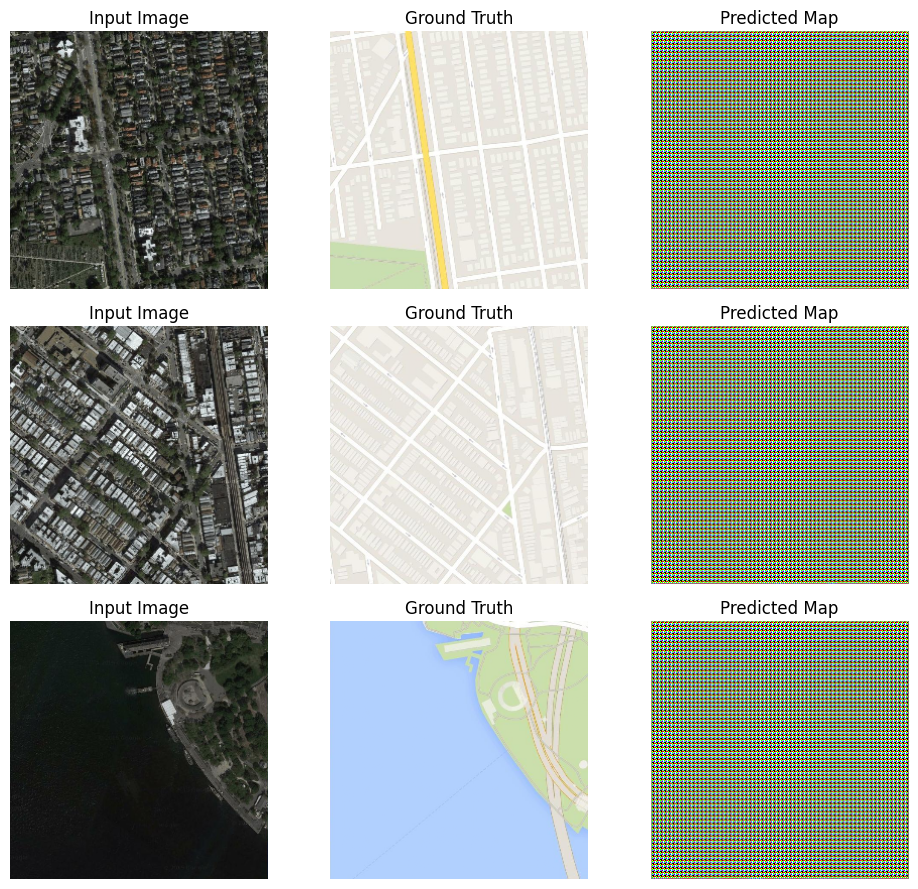

Batch 1000/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4405 , G total_Loss: 1.3150
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step
Batch 1001/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4405 , G total_Loss: 1.3148
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 824ms/step
Batch 1002/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4405 , G total_Loss: 1.3146
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step   
Batch 1003/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4405 , G total_Loss: 1.3144
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step
Batch 1004/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4405 , G total_Loss: 1.3141
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
Batch 1005/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4405 , G total_Loss: 1.3139
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 748ms/step
Batch 1006/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4405 , G total_Loss: 1.3137
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 419ms/step
Batch 1007/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4405 , G total_Loss: 1.3135
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 705ms/step
Batch 1008/1096, D Real_Loss: 0.4404, D Fak

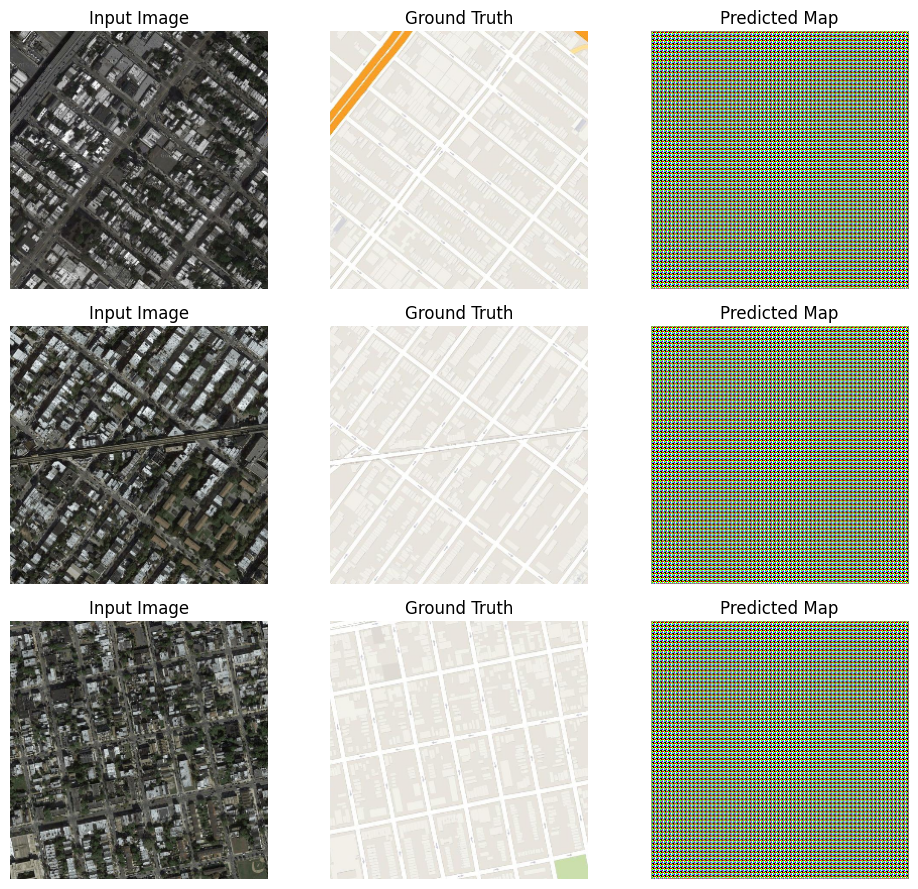

Batch 500/1096, D Real_Loss: 0.4397, D Fake_Loss: 0.4397 , G total_Loss: 1.2034
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step
Batch 501/1096, D Real_Loss: 0.4397, D Fake_Loss: 0.4397 , G total_Loss: 1.2033
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 590ms/step
Batch 502/1096, D Real_Loss: 0.4397, D Fake_Loss: 0.4397 , G total_Loss: 1.2031
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 641ms/step
Batch 503/1096, D Real_Loss: 0.4397, D Fake_Loss: 0.4397 , G total_Loss: 1.2030
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 806ms/step
Batch 504/1096, D Real_Loss: 0.4397, D Fake_Loss: 0.4397 , G total_Loss: 1.2028
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 672ms/step
Batch 505/1096, D Real_Loss: 0.4397, D Fake_Loss: 0.4397 , G total_Loss: 1.2027
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 659ms/step
Batch 506/1096, D Real_Loss: 0.4396, D Fake_Loss: 0.4397 , G total_Loss: 1.2026
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step   
Batch 507/1096, D Real_Loss: 0.4396, D Fake_Loss: 0.4396 , G total_Loss: 1.2024
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
Batch 508/1096, D Real_Loss: 0.4396, D Fake_Loss

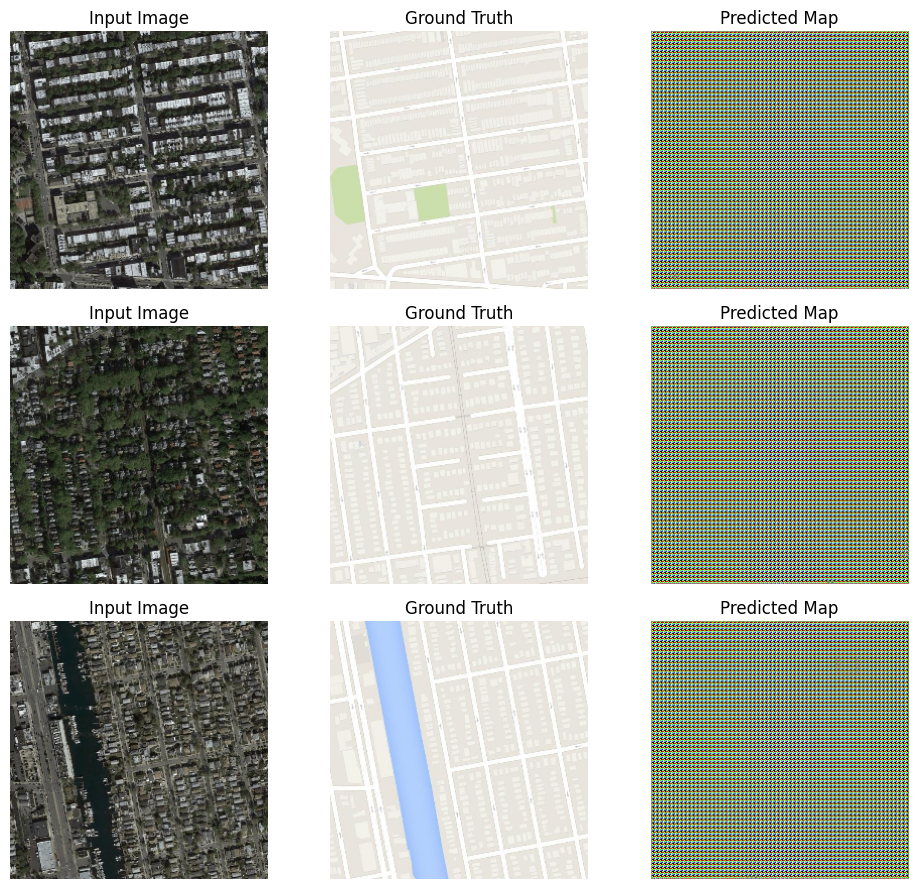

Batch 1000/1096, D Real_Loss: 0.4388, D Fake_Loss: 0.4388 , G total_Loss: 1.1263
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step
Batch 1001/1096, D Real_Loss: 0.4388, D Fake_Loss: 0.4388 , G total_Loss: 1.1262
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 662ms/step
Batch 1002/1096, D Real_Loss: 0.4388, D Fake_Loss: 0.4388 , G total_Loss: 1.1261
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 684ms/step
Batch 1003/1096, D Real_Loss: 0.4387, D Fake_Loss: 0.4388 , G total_Loss: 1.1259
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 734ms/step
Batch 1004/1096, D Real_Loss: 0.4387, D Fake_Loss: 0.4388 , G total_Loss: 1.1258
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
Batch 1005/1096, D Real_Loss: 0.4387, D Fake_Loss: 0.4388 , G total_Loss: 1.1257
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step   
Batch 1006/1096, D Real_Loss: 0.4387, D Fake_Loss: 0.4388 , G total_Loss: 1.1256
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 856ms/step
Batch 1007/1096, D Real_Loss: 0.4387, D Fake_Loss: 0.4388 , G total_Loss: 1.1254
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step   
Batch 1008/1096, D Real_Loss: 0.4387, D Fak

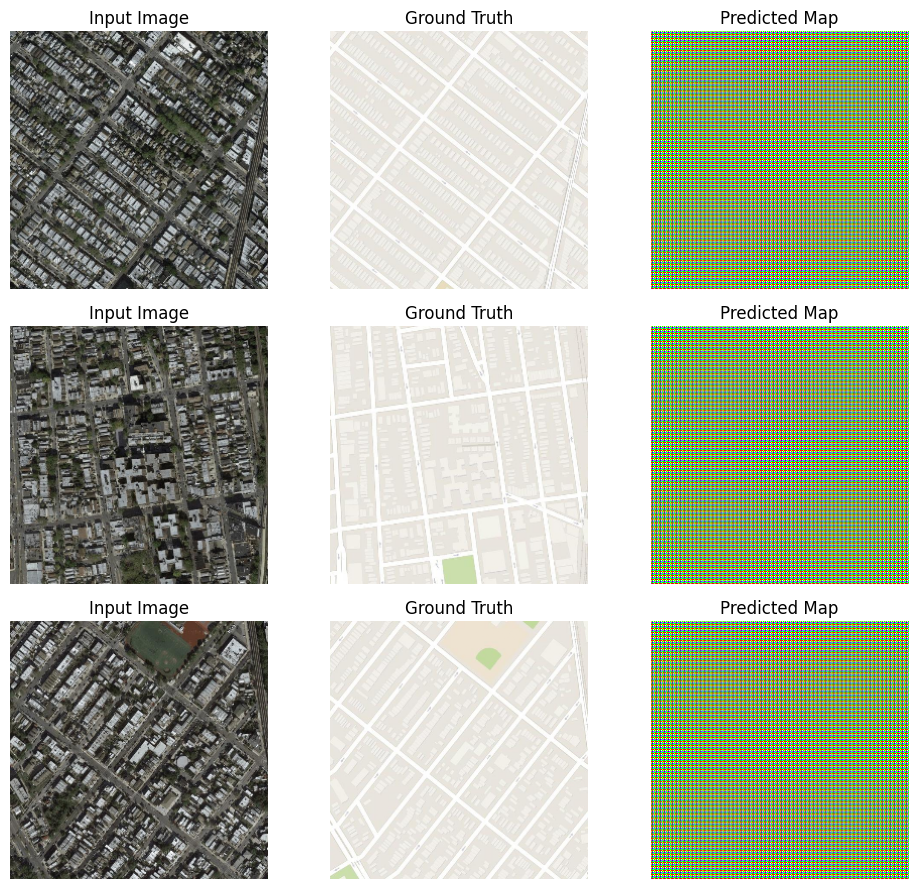

Batch 500/1096, D Real_Loss: 0.4413, D Fake_Loss: 0.4413 , G total_Loss: 1.2619
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step
Batch 501/1096, D Real_Loss: 0.4413, D Fake_Loss: 0.4413 , G total_Loss: 1.2617
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step
Batch 502/1096, D Real_Loss: 0.4413, D Fake_Loss: 0.4413 , G total_Loss: 1.2616
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 498ms/step
Batch 503/1096, D Real_Loss: 0.4413, D Fake_Loss: 0.4413 , G total_Loss: 1.2614
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 672ms/step
Batch 504/1096, D Real_Loss: 0.4413, D Fake_Loss: 0.4413 , G total_Loss: 1.2613
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 914ms/step
Batch 505/1096, D Real_Loss: 0.4413, D Fake_Loss: 0.4413 , G total_Loss: 1.2611
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 704ms/step
Batch 506/1096, D Real_Loss: 0.4413, D Fake_Loss: 0.4414 , G total_Loss: 1.2610
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 705ms/step
Batch 507/1096, D Real_Loss: 0.4413, D Fake_Loss: 0.4414 , G total_Loss: 1.2608
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 595ms/step
Batch 508/1096, D Real_Loss: 0.4413, D Fake_Loss

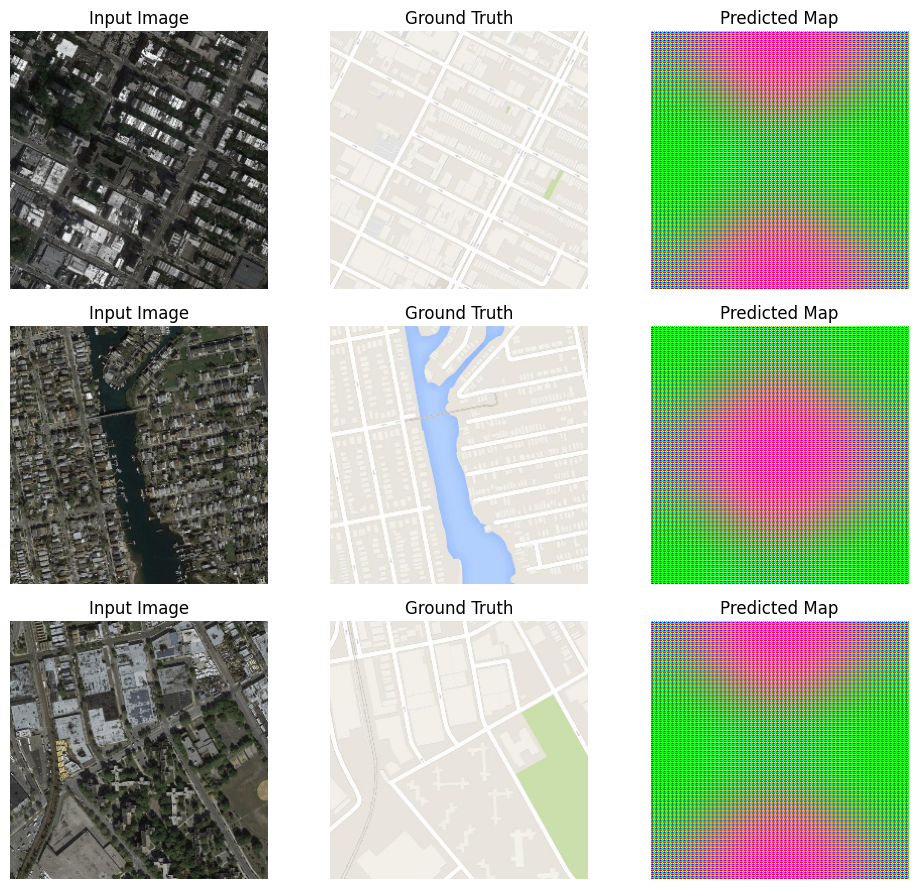

Batch 1000/1096, D Real_Loss: 0.4425, D Fake_Loss: 0.4425 , G total_Loss: 1.1903
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 509ms/step
Batch 1001/1096, D Real_Loss: 0.4425, D Fake_Loss: 0.4425 , G total_Loss: 1.1902
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step
Batch 1002/1096, D Real_Loss: 0.4425, D Fake_Loss: 0.4425 , G total_Loss: 1.1901
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 515ms/step
Batch 1003/1096, D Real_Loss: 0.4425, D Fake_Loss: 0.4425 , G total_Loss: 1.1899
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 611ms/step
Batch 1004/1096, D Real_Loss: 0.4425, D Fake_Loss: 0.4425 , G total_Loss: 1.1898
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 749ms/step
Batch 1005/1096, D Real_Loss: 0.4425, D Fake_Loss: 0.4425 , G total_Loss: 1.1897
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 778ms/step
Batch 1006/1096, D Real_Loss: 0.4425, D Fake_Loss: 0.4425 , G total_Loss: 1.1895
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 675ms/step
Batch 1007/1096, D Real_Loss: 0.4425, D Fake_Loss: 0.4425 , G total_Loss: 1.1894
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 873ms/step
Batch 1008/1096, D Real_Loss: 0.4425, D 

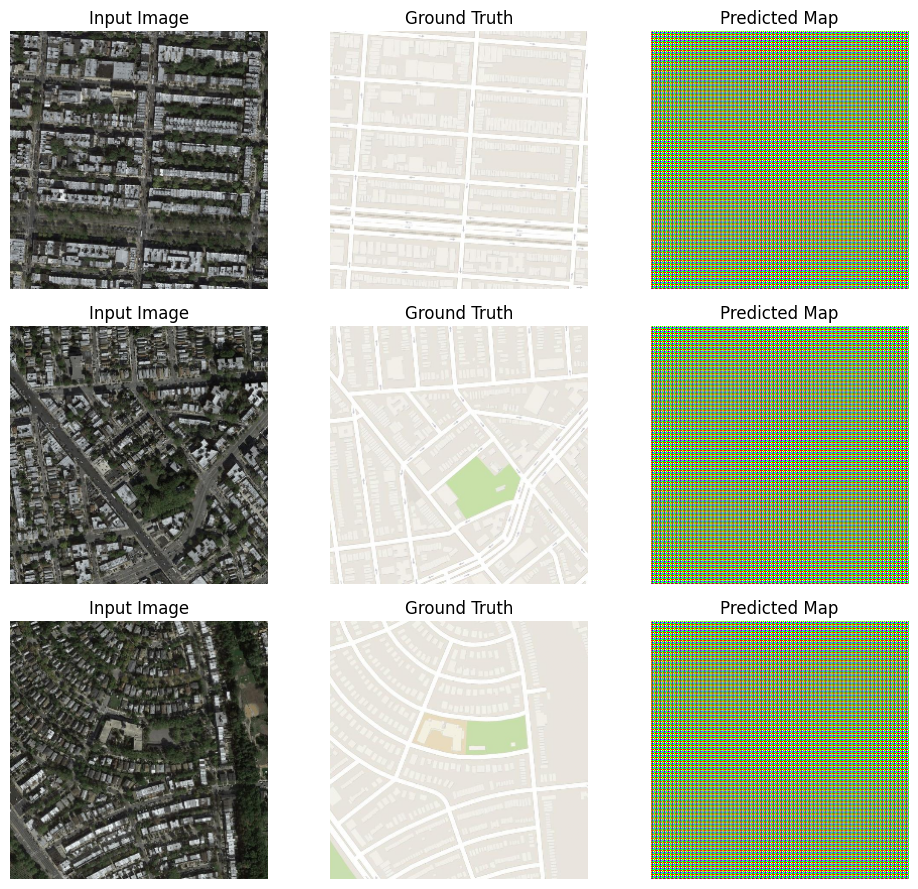

Batch 500/1096, D Real_Loss: 0.4433, D Fake_Loss: 0.4433 , G total_Loss: 1.1179
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step
Batch 501/1096, D Real_Loss: 0.4433, D Fake_Loss: 0.4433 , G total_Loss: 1.1178
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step
Batch 502/1096, D Real_Loss: 0.4433, D Fake_Loss: 0.4433 , G total_Loss: 1.1177
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 694ms/step
Batch 503/1096, D Real_Loss: 0.4433, D Fake_Loss: 0.4433 , G total_Loss: 1.1175
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 489ms/step
Batch 504/1096, D Real_Loss: 0.4433, D Fake_Loss: 0.4433 , G total_Loss: 1.1174
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step   
Batch 505/1096, D Real_Loss: 0.4433, D Fake_Loss: 0.4433 , G total_Loss: 1.1173
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step
Batch 506/1096, D Real_Loss: 0.4433, D Fake_Loss: 0.4433 , G total_Loss: 1.1172
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step
Batch 507/1096, D Real_Loss: 0.4433, D Fake_Loss: 0.4433 , G total_Loss: 1.1171
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
Batch 508/1096, D Real_Loss: 0.4433, D Fake_Loss: 0

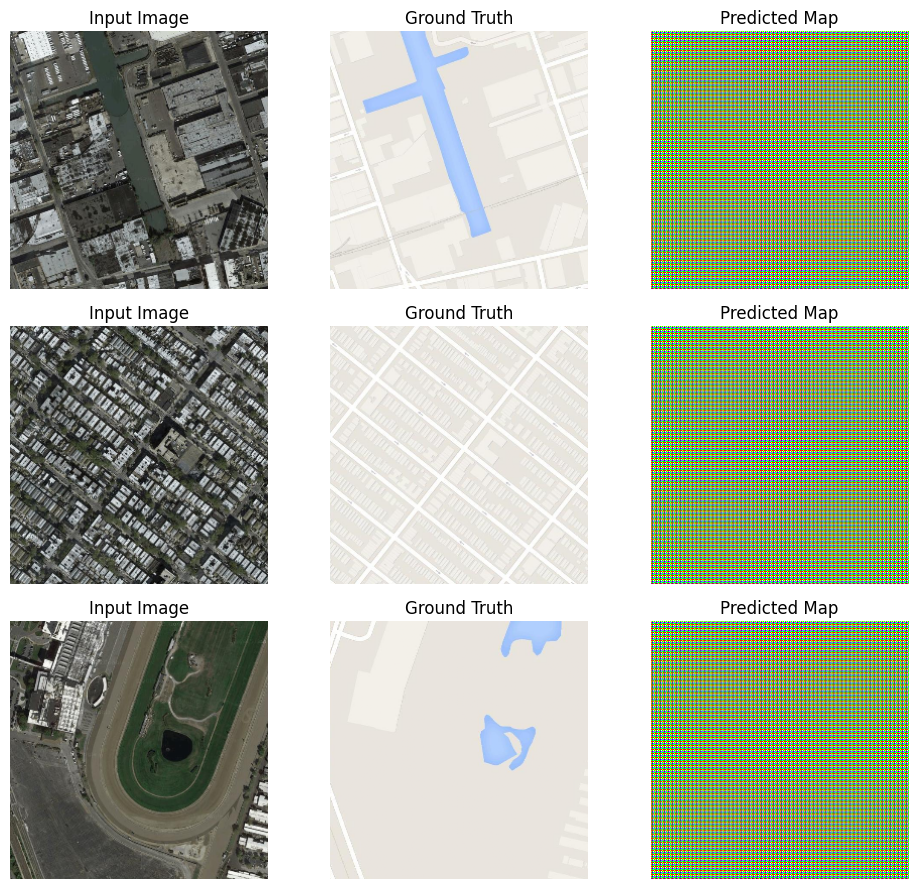

Batch 1000/1096, D Real_Loss: 0.4435, D Fake_Loss: 0.4436 , G total_Loss: 1.0659
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step
Batch 1001/1096, D Real_Loss: 0.4435, D Fake_Loss: 0.4436 , G total_Loss: 1.0658
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step
Batch 1002/1096, D Real_Loss: 0.4435, D Fake_Loss: 0.4436 , G total_Loss: 1.0657
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 666ms/step
Batch 1003/1096, D Real_Loss: 0.4435, D Fake_Loss: 0.4436 , G total_Loss: 1.0656
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 456ms/step
Batch 1004/1096, D Real_Loss: 0.4435, D Fake_Loss: 0.4436 , G total_Loss: 1.0655
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 445ms/step
Batch 1005/1096, D Real_Loss: 0.4435, D Fake_Loss: 0.4436 , G total_Loss: 1.0654
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 571ms/step
Batch 1006/1096, D Real_Loss: 0.4435, D Fake_Loss: 0.4436 , G total_Loss: 1.0653
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step
Batch 1007/1096, D Real_Loss: 0.4435, D Fake_Loss: 0.4436 , G total_Loss: 1.0652
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step
Batch 1008/1096, D Real_Loss: 0.4435, D 

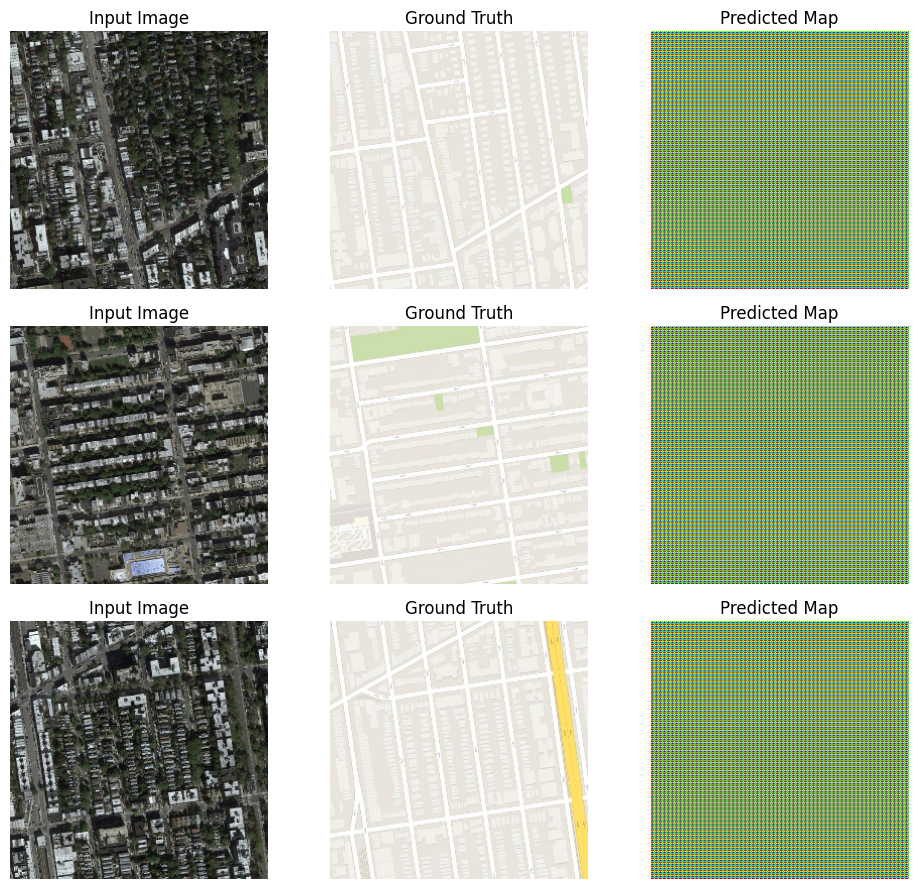

Batch 500/1096, D Real_Loss: 0.4434, D Fake_Loss: 0.4434 , G total_Loss: 1.0175
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step
Batch 501/1096, D Real_Loss: 0.4434, D Fake_Loss: 0.4434 , G total_Loss: 1.0175
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step
Batch 502/1096, D Real_Loss: 0.4434, D Fake_Loss: 0.4434 , G total_Loss: 1.0174
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 799ms/step
Batch 503/1096, D Real_Loss: 0.4434, D Fake_Loss: 0.4434 , G total_Loss: 1.0173
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step
Batch 504/1096, D Real_Loss: 0.4434, D Fake_Loss: 0.4434 , G total_Loss: 1.0172
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step
Batch 505/1096, D Real_Loss: 0.4434, D Fake_Loss: 0.4434 , G total_Loss: 1.0171
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 844ms/step
Batch 506/1096, D Real_Loss: 0.4434, D Fake_Loss: 0.4434 , G total_Loss: 1.0170
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step
Batch 507/1096, D Real_Loss: 0.4434, D Fake_Loss: 0.4434 , G total_Loss: 1.0169
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step
Batch 508/1096, D Real_Loss: 0.4434, D Fake_Loss

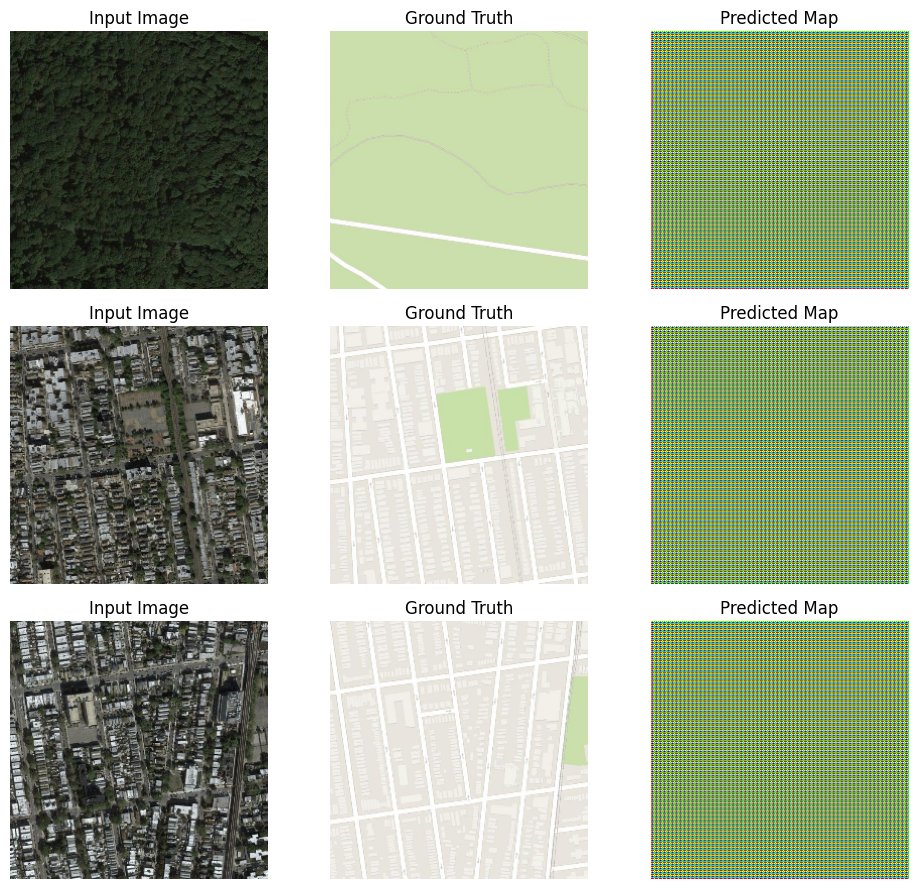

Batch 1000/1096, D Real_Loss: 0.4431, D Fake_Loss: 0.4432 , G total_Loss: 0.9775
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 384ms/step
Batch 1001/1096, D Real_Loss: 0.4431, D Fake_Loss: 0.4432 , G total_Loss: 0.9774
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step
Batch 1002/1096, D Real_Loss: 0.4431, D Fake_Loss: 0.4432 , G total_Loss: 0.9774
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 732ms/step
Batch 1003/1096, D Real_Loss: 0.4431, D Fake_Loss: 0.4432 , G total_Loss: 0.9773
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 480ms/step
Batch 1004/1096, D Real_Loss: 0.4431, D Fake_Loss: 0.4432 , G total_Loss: 0.9772
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 474ms/step
Batch 1005/1096, D Real_Loss: 0.4431, D Fake_Loss: 0.4432 , G total_Loss: 0.9771
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 756ms/step
Batch 1006/1096, D Real_Loss: 0.4431, D Fake_Loss: 0.4432 , G total_Loss: 0.9771
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 511ms/step
Batch 1007/1096, D Real_Loss: 0.4431, D Fake_Loss: 0.4431 , G total_Loss: 0.9770
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step
Batch 1008/1096, D Real_Loss: 0.4431, D 

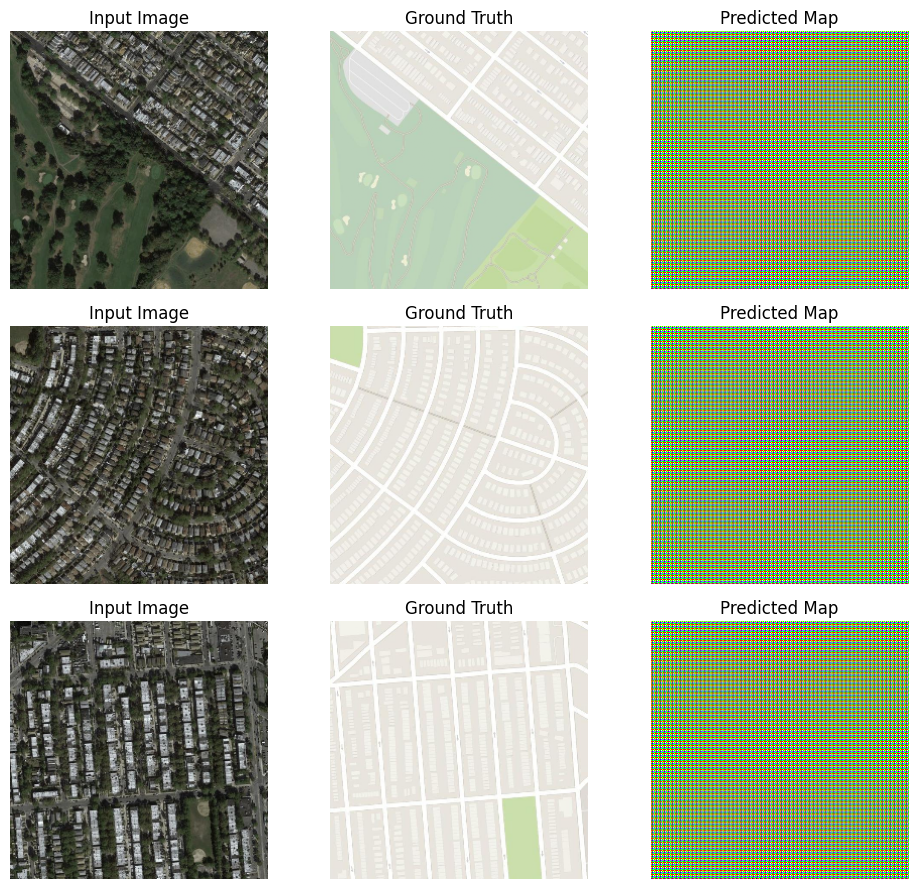

Batch 500/1096, D Real_Loss: 0.4426, D Fake_Loss: 0.4426 , G total_Loss: 0.9357
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step
Batch 501/1096, D Real_Loss: 0.4426, D Fake_Loss: 0.4426 , G total_Loss: 0.9357
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step
Batch 502/1096, D Real_Loss: 0.4426, D Fake_Loss: 0.4426 , G total_Loss: 0.9356
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step
Batch 503/1096, D Real_Loss: 0.4426, D Fake_Loss: 0.4426 , G total_Loss: 0.9356
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step
Batch 504/1096, D Real_Loss: 0.4426, D Fake_Loss: 0.4426 , G total_Loss: 0.9355
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 750ms/step
Batch 505/1096, D Real_Loss: 0.4425, D Fake_Loss: 0.4426 , G total_Loss: 0.9354
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step
Batch 506/1096, D Real_Loss: 0.4425, D Fake_Loss: 0.4426 , G total_Loss: 0.9354
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step
Batch 507/1096, D Real_Loss: 0.4425, D Fake_Loss: 0.4426 , G total_Loss: 0.9353
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 461ms/step
Batch 508/1096, D Real_Loss: 0.4425, D Fake_Loss

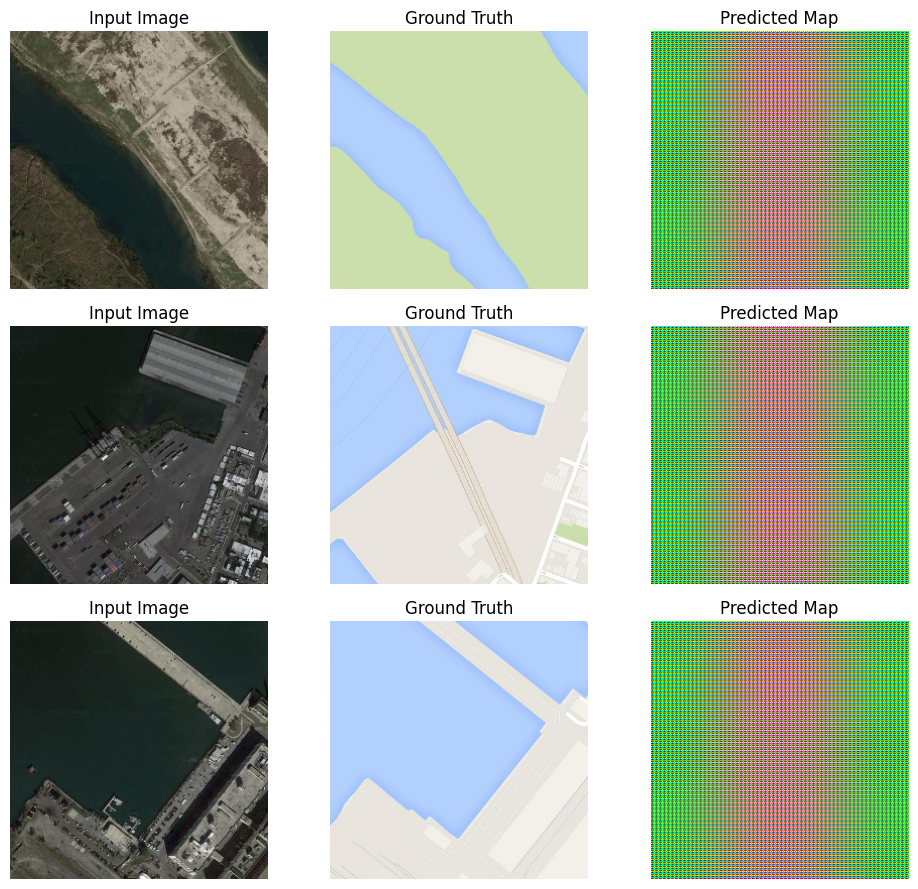

Batch 1000/1096, D Real_Loss: 0.4419, D Fake_Loss: 0.4419 , G total_Loss: 0.9048
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step
Batch 1001/1096, D Real_Loss: 0.4419, D Fake_Loss: 0.4419 , G total_Loss: 0.9047
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step
Batch 1002/1096, D Real_Loss: 0.4419, D Fake_Loss: 0.4419 , G total_Loss: 0.9047
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 530ms/step
Batch 1003/1096, D Real_Loss: 0.4419, D Fake_Loss: 0.4419 , G total_Loss: 0.9046
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 486ms/step
Batch 1004/1096, D Real_Loss: 0.4419, D Fake_Loss: 0.4419 , G total_Loss: 0.9045
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step
Batch 1005/1096, D Real_Loss: 0.4419, D Fake_Loss: 0.4419 , G total_Loss: 0.9045
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 682ms/step
Batch 1006/1096, D Real_Loss: 0.4419, D Fake_Loss: 0.4419 , G total_Loss: 0.9044
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step
Batch 1007/1096, D Real_Loss: 0.4419, D Fake_Loss: 0.4419 , G total_Loss: 0.9044
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step
Batch 1008/1096, D Real_Loss: 0.4419, D 

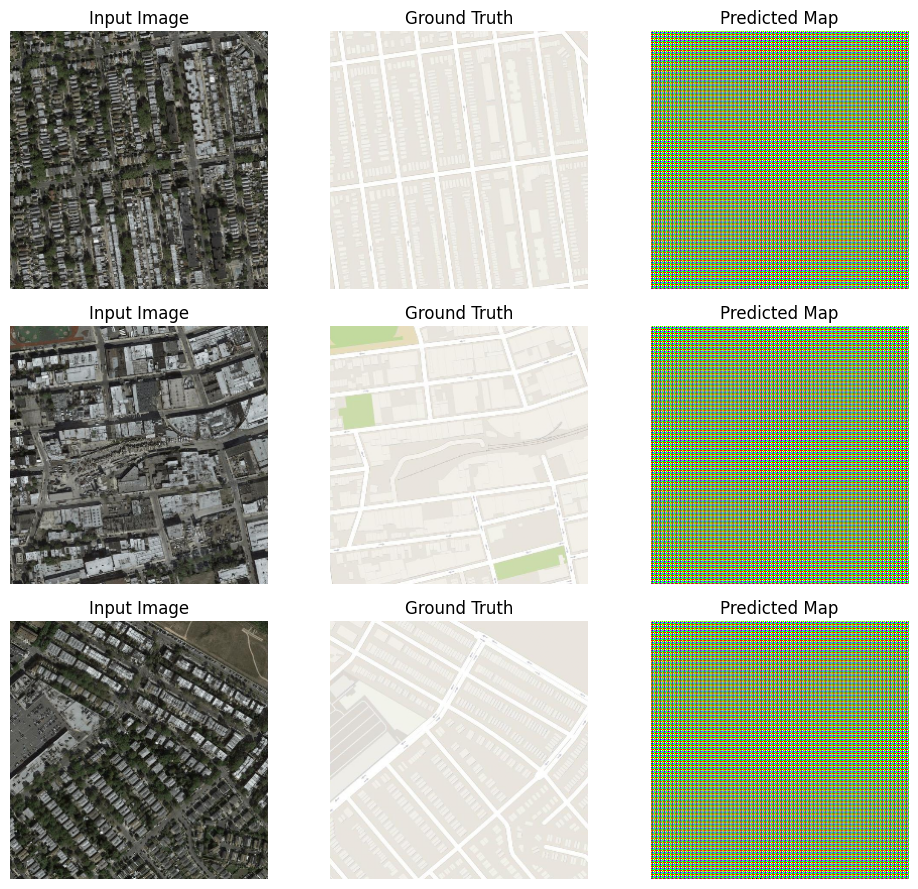

Batch 500/1096, D Real_Loss: 0.4409, D Fake_Loss: 0.4409 , G total_Loss: 0.8719
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 577ms/step
Batch 501/1096, D Real_Loss: 0.4409, D Fake_Loss: 0.4409 , G total_Loss: 0.8718
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step
Batch 502/1096, D Real_Loss: 0.4409, D Fake_Loss: 0.4409 , G total_Loss: 0.8717
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 656ms/step
Batch 503/1096, D Real_Loss: 0.4409, D Fake_Loss: 0.4409 , G total_Loss: 0.8717
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 622ms/step
Batch 504/1096, D Real_Loss: 0.4409, D Fake_Loss: 0.4409 , G total_Loss: 0.8716
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 495ms/step
Batch 505/1096, D Real_Loss: 0.4409, D Fake_Loss: 0.4409 , G total_Loss: 0.8716
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 509ms/step
Batch 506/1096, D Real_Loss: 0.4409, D Fake_Loss: 0.4409 , G total_Loss: 0.8715
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 845ms/step
Batch 507/1096, D Real_Loss: 0.4409, D Fake_Loss: 0.4409 , G total_Loss: 0.8715
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 624ms/step
Batch 508/1096, D Real_Loss: 0.4409, D Fake_Loss

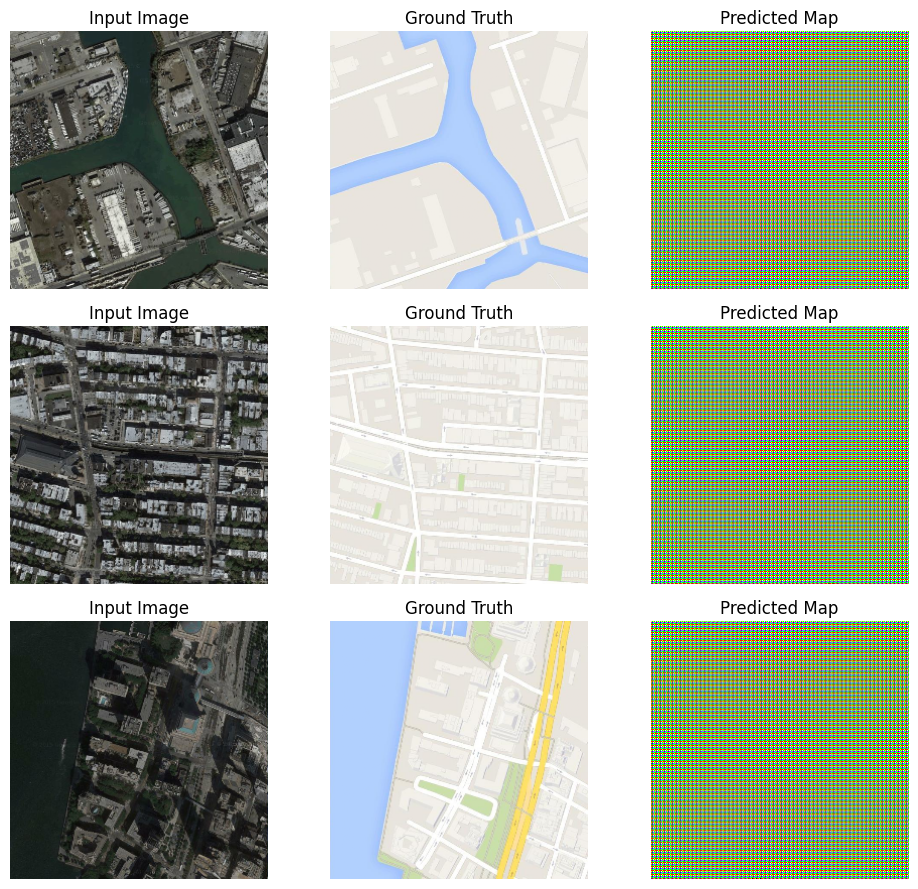

Batch 1000/1096, D Real_Loss: 0.4399, D Fake_Loss: 0.4399 , G total_Loss: 0.8473
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 599ms/step
Batch 1001/1096, D Real_Loss: 0.4399, D Fake_Loss: 0.4399 , G total_Loss: 0.8473
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step
Batch 1002/1096, D Real_Loss: 0.4399, D Fake_Loss: 0.4399 , G total_Loss: 0.8472
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 698ms/step
Batch 1003/1096, D Real_Loss: 0.4399, D Fake_Loss: 0.4399 , G total_Loss: 0.8472
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 687ms/step
Batch 1004/1096, D Real_Loss: 0.4399, D Fake_Loss: 0.4399 , G total_Loss: 0.8471
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 703ms/step
Batch 1005/1096, D Real_Loss: 0.4399, D Fake_Loss: 0.4399 , G total_Loss: 0.8471
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 773ms/step
Batch 1006/1096, D Real_Loss: 0.4399, D Fake_Loss: 0.4399 , G total_Loss: 0.8470
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 578ms/step
Batch 1007/1096, D Real_Loss: 0.4399, D Fake_Loss: 0.4399 , G total_Loss: 0.8470
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 783ms/step
Batch 1008/1096, D Real_Loss: 0.4399, D 

In [15]:
# Train the model
train_on_batch(generator_model, discriminator_model, gan_model, sat_train, train_map, val_sat,val_map)

In [20]:
# load the trained Generator
try:
	generator_model_epoch40 = tf.keras.models.load_model(os.path.join(models_direc, 'generator_model_epoch39_batch999.keras'))
except Exception as e:
	print("Failed to load model. The file may be corrupted or incomplete.")
	print("Error details:", e)

Failed to load model. The file may be corrupted or incomplete.
Error details: Bad CRC-32 for file 'model.weights.h5'


### The model was trained for 40 epochs and loads fine on Google Colab. The corresponding file is included in the repository.